<center><img src = "header_escom26.jpg"  height="100" width="250"></img></center>
<h1><center>INSTITUTO POLITECNICO NACIONAL</center></h1>
<h2><center>Escuela Superior de Cómputo</center></h2>
<h2><center>Image Analysis</center></h2>
<h2><center>Practice 2 Resizing</center></h2>
<h2><center>Student name: Pérez Leal Rodolfo</center></h2>
<h2><center>Boleta: 2016630302</center></h2>

<h1> Introduction </h1>
<p>
    The process of resizing an image involve an image interpolation on this process the image is distort from one grid to another of diferent size. Image resizing is necessary to increase or decrease the total number of pixels. Zooming refers to increase the quantity of pixels, so that when you zoom an image, you will see more detail.
</p>
<p>
    Interpolation works by using known data to estimate values at unknown points. Image interpolation works in two directions, and tries to achieve a best approximation of a pixel's color based on the values at surrounding pixels. The image illustrates how resizing works:
</p>
<center><img src = "img1.JPG" width = "500" height = "350"></center>


<p>In real Images pixel values can change far more abruptly from one location to the next not like the ideal gradient above. Then more you know about the surrounding pixels, better the interpolation will become.  Therefore results quickly deteriorate while stretching an image, and interpolation can never add detail to the image.</p>
<p>There are different types of interpolation algorithms like the bicubic interpolation or the bicubic interpolation, but the basic one is the linear interpoletation.</p>
<p>In mathematics, linear interpolation is a method of curve fitting using linear polynomials to construct new data points within the range of a discrete set of known data points. If the two known points are given by the coordinates \( (x_0 , y_0)\) and \((x_1 , y_1)\). The linear interpolantion is the straight line between these points. For a value x in the interval \( (x_{0},x_{1})\), the value y along the straight line is given from the equation of slopes: $$\frac{y-y_0}{x-x_0} = \frac{y_1-y_0}{x_1-x_0}$$</p>
<img src = "img2.png" width = "300" height = "200">
Finally we obtain the line equation for \(y\) which is the unkwon for a given \(x\)  given for the resampling. $$ y = (x - x_1) \frac{y_2 - y_1}{x_2 - x_1} + y_1 $$</p>



<h1> Practice </h1>

Import numphy and matplotlib packages from PIL.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from PIL import Image

Using PIL and matplotlib to open, read and display the images.

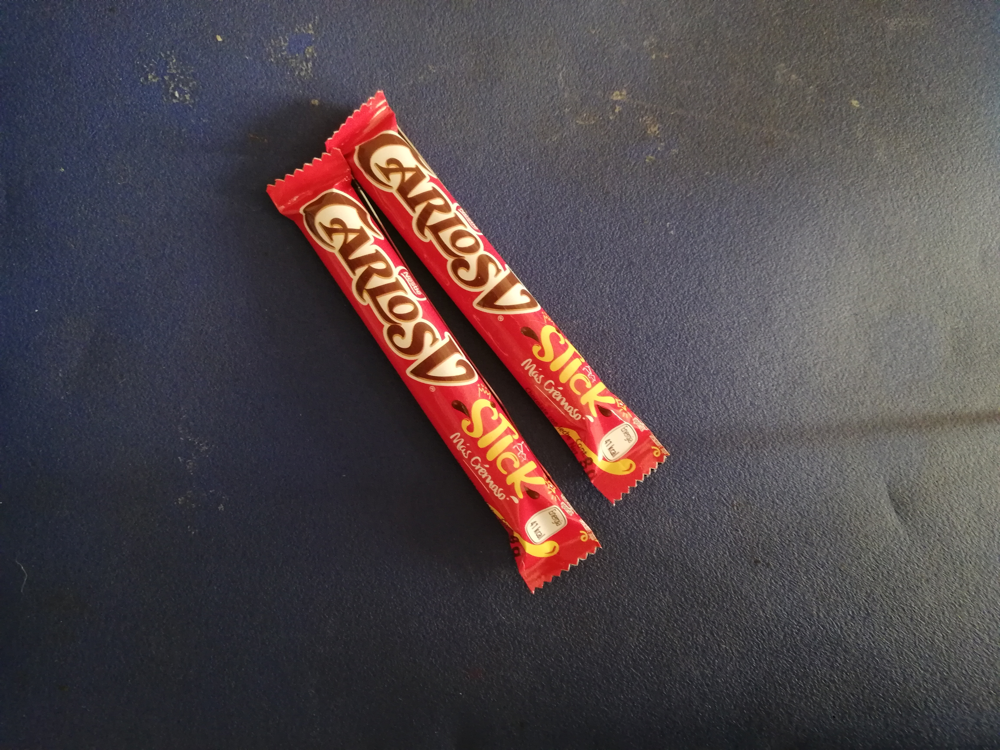

In [2]:
filepath = "./" #The current directory
filename = "dulces.jpg"
pic = Image.open(filepath + filename) #Open the image
pic #Diplays the image in the notebook

Convert the image to an Numpy Array to get the original Height and Width

In [3]:
pic_arr = np.asarray(pic) #converts the image to an Numpy Array
H = pic_arr.shape[0]
W = pic_arr.shape[1]
print("Height: ", H, "Width: ", W)

Height:  3456 Width:  4608


Ask the scale factor

In [9]:
cont = False
scalex = 0
scaley = 0
while cont == False:
    try:
        scalex = float(input("New Scale x: "))
        scaley = float(input("New Scale y: "))
        cont = True
    except ValueError:
        print("Error can´t convert to float")

New Scale x:  .5
New Scale y:  .5


Create two new images to scale the original image. <br>
One to scale the image in the width and other to scale the image in the height and be the final image.

In [10]:
H2 = int(H * scaley)
W2 = int(W * scalex)
channels = pic_arr.shape[2]
pic_scale = np.zeros((H2, W2, 3), dtype=np.uint8)
pic_scalex = np.zeros((H, W2, 3), dtype=np.uint8)
print("New size: ", pic_scale.shape)

New size:  (1728, 2304, 3)


The function scaley() scale the image in the y axis (height) from the auxiliar image that previous was scaled on the x axis(width).<br>
The scalex() scale the image on the width and save the image on a temporaly array that have the original height and the new width.<br>
on the formula:  $$ y = (x - x_1) \frac{y_2 - y_1}{x_2 - x_1} + y_1 $$ there are some observations like: <br>
<li>
    <ul>The \(x\) value is given by multiply the steep from the new image and the x that we want to know</ul>
    <ul>\(x_1\) is the floor function from the \(x\) value </ul>
    <ul>\(x_2 - x_1\) is always equals to one </ul>
    <ul>\(x_1\) is the floor function from the \(x\) value </ul>
    <ul>\(y_1\) is the value of the array on the index on the floor value of the x</ul>
    <ul>\(y_2\) is the value of the array on the index on the ceil value of the x</ul>
</li>

In [11]:
#function to resize columns
def scaley(line, index, step, lenght, color):    
    for x in range(1, lenght-1):
        xa = float(step * x)
        x1 = int(np.floor(xa))
        x2 = int(np.ceil(xa))
        if x1 > lenght - 1:
            x1 = lenght - 1
        if x2 > lenght - 1:
            x2 = lenght - 1
        xr = xa - x1
        y1 = line[x1]
        yr = xr * (line[x2] - y1) + y1
        yr = int (np.floor(yr))
        if yr >= 255:
            yr = 254
        pic_scale[x, index, color] =  yr

    pic_scale[0, index, color] = line[0]
    pic_scale[lenght-1, index, color] = line[line.shape[0] - 1]

def scalex(line, index, step, lenght, color):    
    for x in range(1, lenght-1):
        xa = float(step * x)
        x1 = int(np.floor(xa))
        x2 = int(np.ceil(xa))
        if x1 > lenght - 1:
            x1 = lenght - 1
        if x2 > lenght - 1:
            x2 = lenght - 1
        xr = xa - x1
        y1 = line[x1]
        yr = xr * (line[x2] - y1) + y1
        yr = int (np.floor(yr))
        if yr > 255:
            yr = 255
        pic_scalex[index, x, color] =  yr

    pic_scalex[index, 0, color] = line[0]
    pic_scalex[index, lenght-1, color] = line[line.shape[0] - 1]
    # col = pic_arr[:, i]    #height

First we resize the width of the image traveling all the rows and processing every one for each color channel from the original array image and saving this on a auxiliar matrix with the original height and the new width.<br>
Then we obtain the step from resizing on the heigth and do the same process for every column from the auxiliar matrix to the matrix with the new height and width.

In [12]:
#travel each column
def resize():
    step = float(H/H2)
    #scale X
    for i in range (H):
        col = pic_arr[i, :, 0]    
        scalex(col, i, step, W2, 0)
        col = pic_arr[i, :, 1]    
        scalex(col, i, step, W2, 1)
        col = pic_arr[i, :, 2]    
        scalex(col, i, step, W2, 2)
    
    step = float(W/W2)
    #scale Y
    for i in range (W2):
        col = pic_scalex[:, i, 0]    
        scaley(col, i, step, H2, 0)
        col = pic_scalex[:, i, 1]    
        scaley(col, i, step, H2, 1)
        col = pic_scalex[:, i, 2]    
        scaley(col, i, step, H2, 2)


We call the process that resize the image but with a little error that make the borders repeat and lose a portion of the original image.

Wall time: 4min 39s
Original Height:  3456 Width:  4608
New Height:  1728 Width:  2304


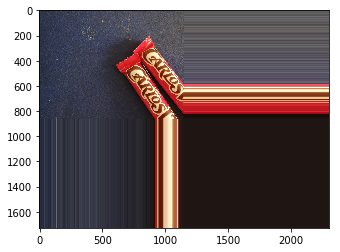

In [14]:
%time resize()
print("Original Height: ", H, "Width: ", W)
print("New Height: ", H2, "Width: ", W2)
plt.imshow(pic_scale)

<h1>Conclutions</h1>
<p>
    The resize of an image could be usefull to have less information to process. On this practice was a little confusing because I think that scaling the image first the width and then the height could solve the problem but from my algorithm cause a error that resize a portion of the image but on the border repeat the  same pixel and one corner is lost.</p>
<p>Also I can't use cython to reduce the time of proccessing the image so then scaling images to a bigger scale or scaling big images take a lot of time to finnish.</p>